## Import Library

In [1]:
import pandas as pd 
import itertools
import string
import numpy as np
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
pd.set_option('display.max_rows', None)

## Data Preparation

In [3]:
df = pd.read_csv('drugsComTrain.tsv', sep='\t')

In [4]:
df.head()

,Unnamed: 0,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9.0,"May 20, 2012",27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8.0,"April 27, 2010",192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5.0,"December 14, 2009",17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8.0,"November 3, 2015",10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9.0,"November 27, 2016",37


In [5]:
df.condition.value_counts()

condition
Birth Control                                                          28788
Depression                                                              9069
Pain                                                                    6145
Anxiety                                                                 5904
Acne                                                                    5588
Bipolar Disorde                                                         4224
Insomnia                                                                3673
Weight Loss                                                             3609
Obesity                                                                 3568
ADHD                                                                    3383
Diabetes, Type 2                                                        2554
Emergency Contraception                                                 2463
High Blood Pressure                                               

In [6]:
# Melakukan train pada beberapa condition yang dipilih (10 Kondisi)
df_train = df[(df['condition'] == 'Birth Control') | (df['condition'] == 'Depression') | (df['condition'] == 'Anxiety') | (df['condition'] == 'Pain') | (df['condition'] == 'Insomnia') | (df['condition'] == 'Obesity' ) | (df['condition'] == 'ADHD') | (df['condition'] == 'Diabetes, Type 2') | (df['condition'] == 'High Blood Pressure') | (df['condition'] == 'Smoking Cessation')]

In [7]:
# Cek berapa jumlah keseluruhan baris dan kolom pada data
df.shape

(161297, 7)

In [8]:
# Cek berapa jumlah keseluruhan baris dan kolom pada data df_train
df_train.shape

(67185, 7)

Text(0.5, 1.0, 'Semua kondisi (1-10)')

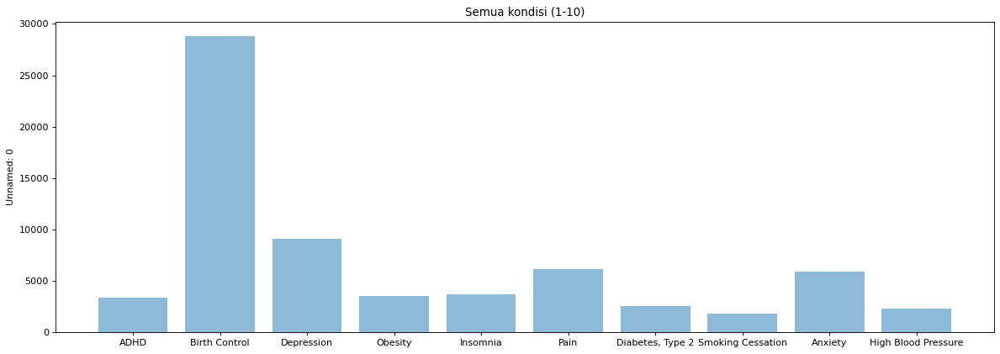

In [9]:
# Membuat plot untuk melihat jumlah keseluruhan kondisi menggunakan barplot
objects = df_train['condition'].unique()
y_pos = np.arange(len(objects))
performance = [len(df_train[df_train['condition'] == condition]) for condition in df_train['condition'].unique()]

plt.figure(figsize=(18,6), dpi= 80)
plt.bar(y_pos[:10], performance[:10], align='center', alpha=0.5)
plt.xticks(y_pos[:10], objects[:10])
plt.ylabel('Unnamed: 0')
plt.title('Semua kondisi (1-10)')

In [10]:
# Menghapus kolom yang tidak diperlukan dari data tersebut 
X = df_train.drop(['Unnamed: 0', 'drugName', 'rating', 'date', 'usefulCount'], axis=1)

In [11]:
# Cek semua jumlah kondisi yang ada pada data X
X.condition.value_counts()

condition
Birth Control          28788
Depression              9069
Pain                    6145
Anxiety                 5904
Insomnia                3673
Obesity                 3568
ADHD                    3383
Diabetes, Type 2        2554
High Blood Pressure     2321
Smoking Cessation       1780
Name: count, dtype: int64

## Exploratory Data Analysis (EDA)

In [12]:
X.head()

,condition,review
1,ADHD,"""My son is halfway through his fourth week of ..."
2,Birth Control,"""I used to take another oral contraceptive, wh..."
3,Birth Control,"""This is my first time using any form of birth..."
9,Birth Control,"""I had been on the pill for many years. When m..."
11,Depression,"""I have taken anti-depressants for years, with..."


In [13]:
#  Memisahkan masing-masing data frame untuk menganalisis kondisi masing-masing 
X_birth=X[(X['condition']=='Birth Control')]
X_dep=X[(X['condition']=='Depression')]
X_anx=X[(X['condition']=='Anxiety')]
X_pn=X[(X['condition']=='Pain')]
X_ins=X[(X['condition']=='Insomnia')]
X_obs=X[(X['condition']=='Obesity')]
X_adhd=X[(X['condition']=='ADHD')]
X_diab=X[(X['condition']=='Diabetes, Type 2')]
X_bp=X[(X['condition']=='High Blood Pressure')]
X_smk=X[(X['condition']=='Smoking Cessation')]

Text(0.5, 1.0, 'Word cloud for Birth Control')

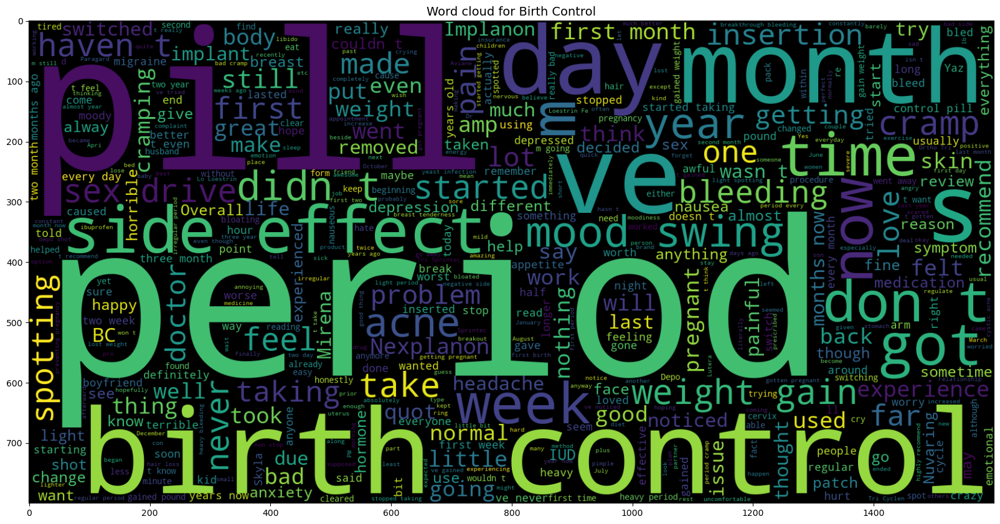

In [14]:
# Menggunakan Word Cloud untuk menemukan kata yang paling sering muncul 
# Pada X_birth
from wordcloud import WordCloud 
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_birth.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Birth Control', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Depression')

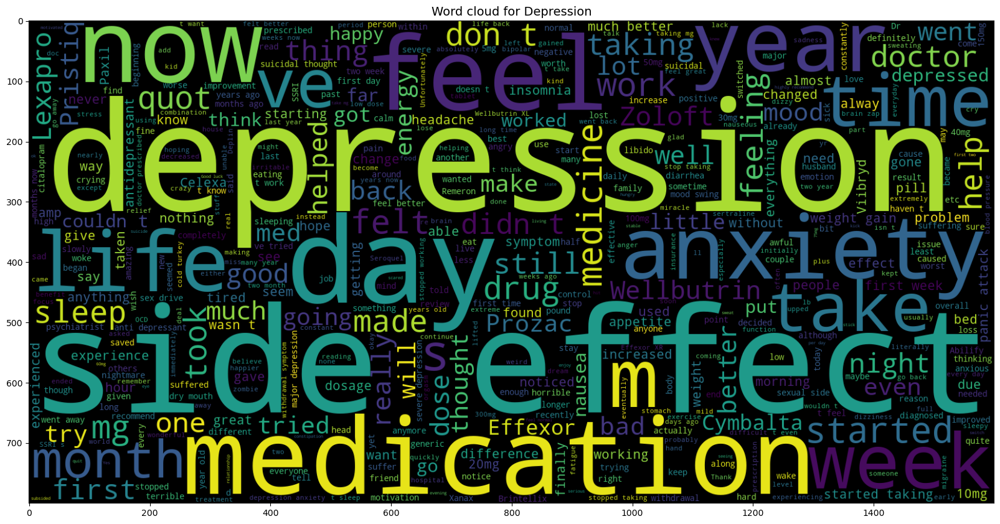

In [15]:
# Pada depression
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_dep.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Depression', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Anxiety')

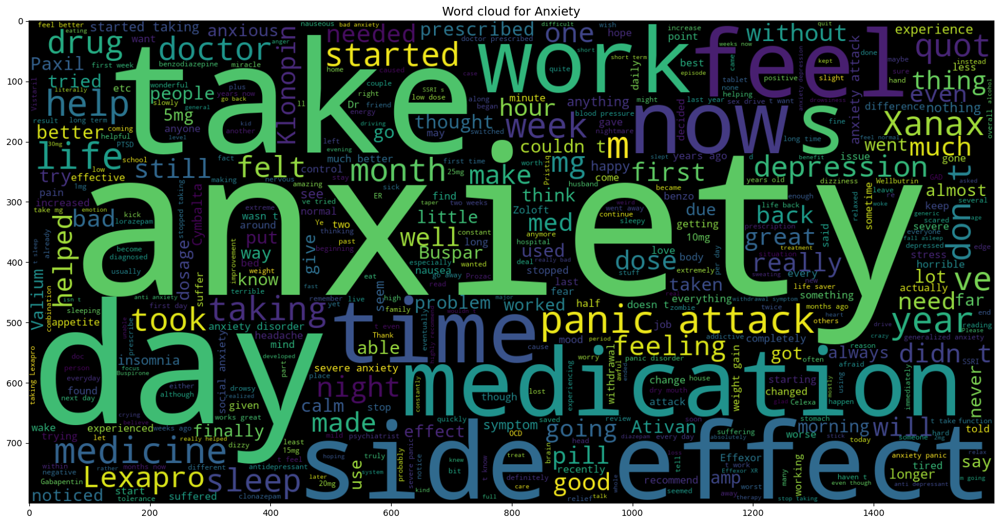

In [16]:
# Pada Anxiety 
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_anx.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Anxiety', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Pain')

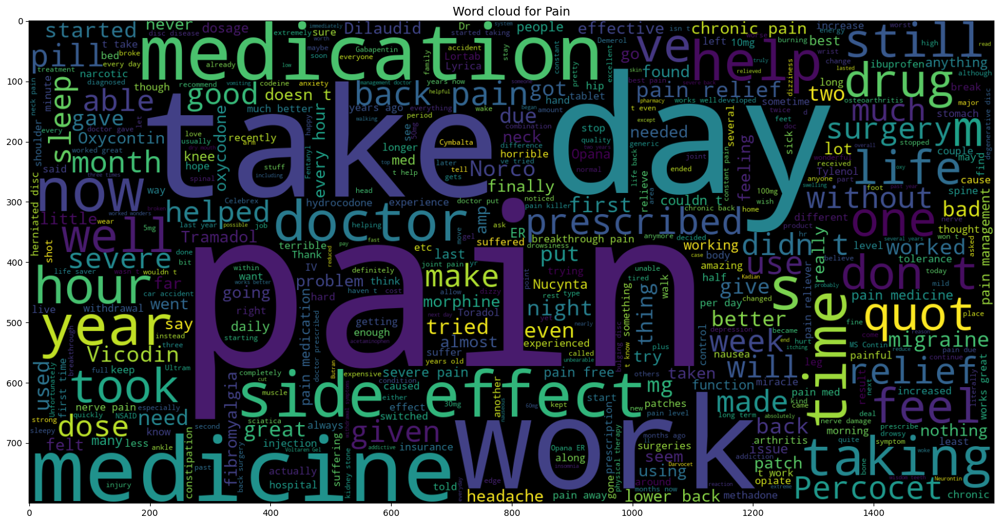

In [17]:
# Pada pain 
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_pn.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Pain', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Insomnia')

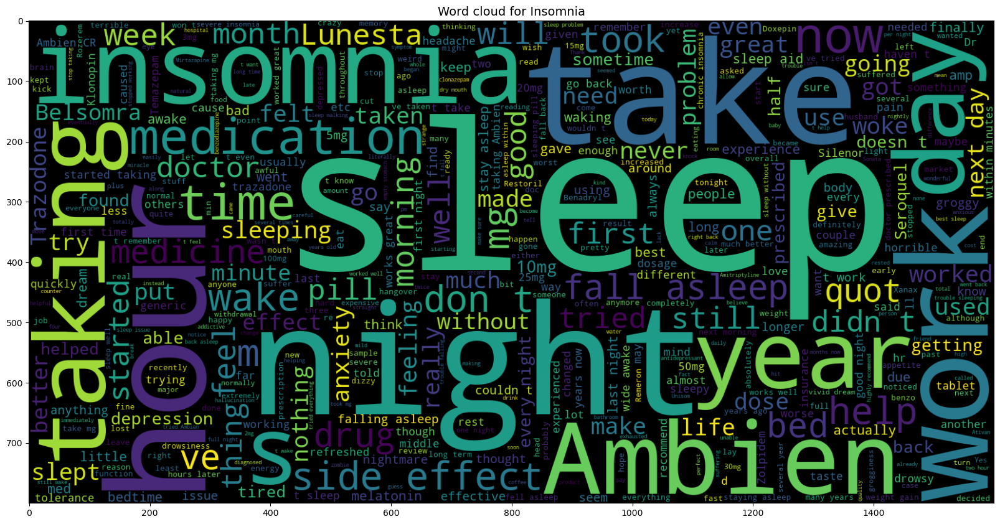

In [18]:
# Pada Insomnia 
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_ins.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Insomnia', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Obesity')

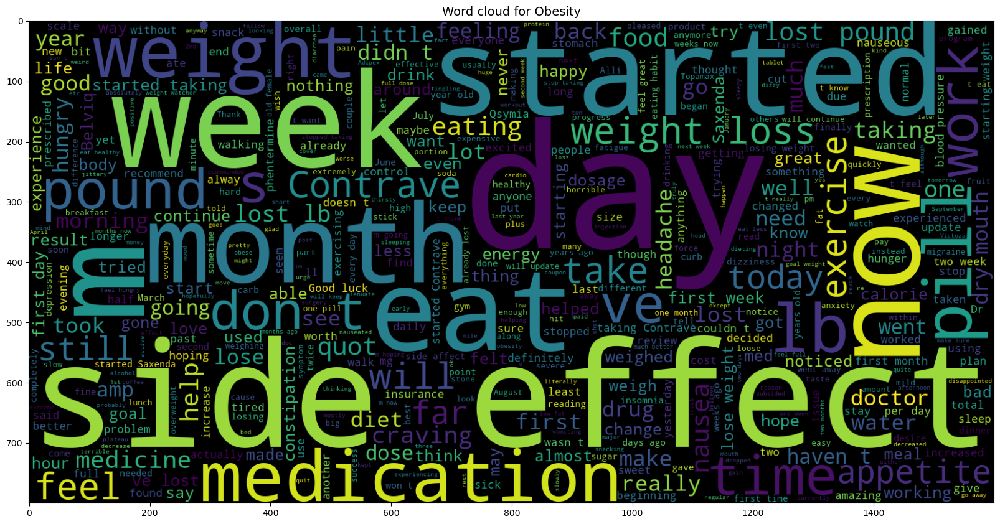

In [19]:
# Pada Obesity
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_obs.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Obesity', fontsize=14)

Text(0.5, 1.0, 'Word cloud for ADHD')

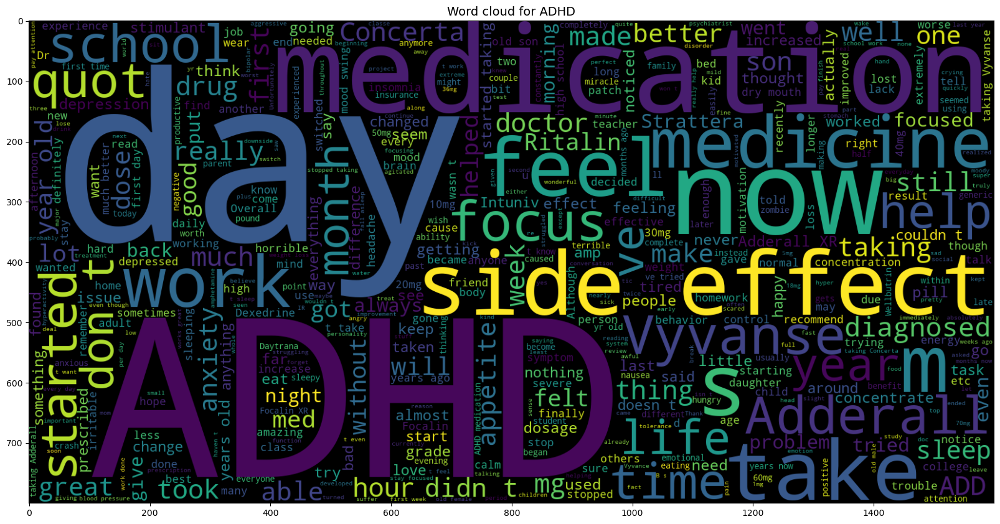

In [20]:
# Pada ADHD
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_adhd.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for ADHD', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Diabetes Type 2')

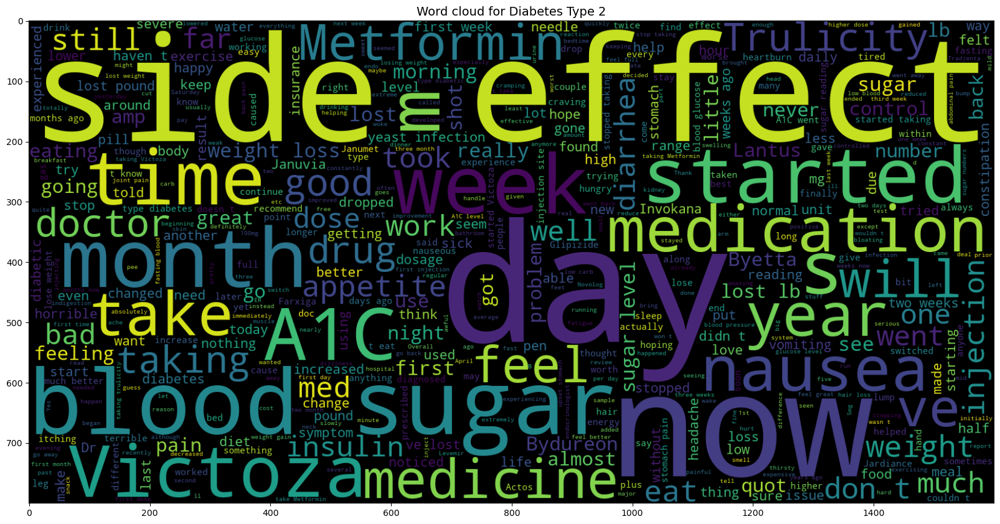

In [21]:
# Pada diabetes type 2 
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_diab.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Diabetes Type 2', fontsize=14)

Text(0.5, 1.0, 'Word cloud for High Blood Pressure')

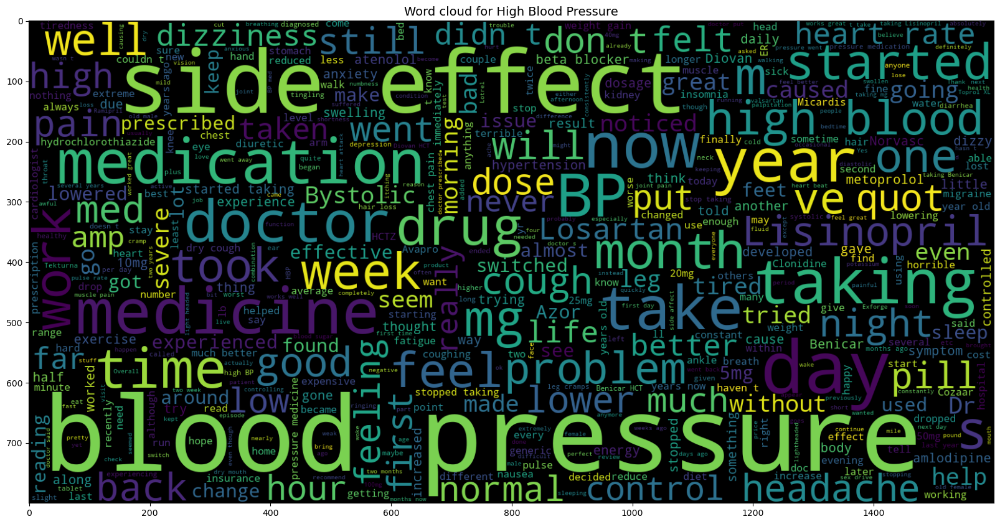

In [22]:
# Pada High Blood Pressure
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_bp.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for High Blood Pressure', fontsize=14)

Text(0.5, 1.0, 'Word cloud for Smoking Cessation')

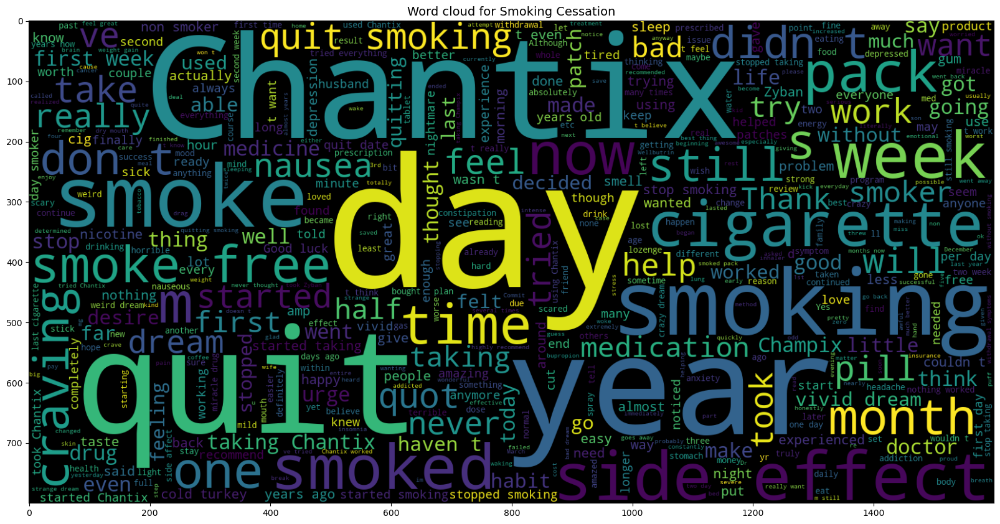

In [23]:
# Pada Smoking Cessation
plt.figure(figsize= (20, 20))
wc = WordCloud(max_words = 500, width=1600, height=800).generate(" ".join(X_smk.review))
plt.imshow(wc, interpolation='bilinear')
plt.title('Word cloud for Smoking Cessation', fontsize=14)

## Data Preprocessing

In [24]:
# Cek data X
X.head()

,condition,review
1,ADHD,"""My son is halfway through his fourth week of ..."
2,Birth Control,"""I used to take another oral contraceptive, wh..."
3,Birth Control,"""This is my first time using any form of birth..."
9,Birth Control,"""I had been on the pill for many years. When m..."
11,Depression,"""I have taken anti-depressants for years, with..."


In [25]:
# Cek beberapa review 
X['review'][2]

'"I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas."'

In [26]:
X['review'][11]

'"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."'

In [27]:
# Menghilangkan " pada kolom review
for i, col in enumerate(X.columns):
    X.iloc[:, i] = X.iloc[:, i].str.replace('"', '')

In [28]:
# Mengatur lebar (width) dari column ke maksimal
pd.set_option("max_colwidth", None)

In [29]:
# Mengecek kembali proses 
X.head()

,condition,review
1,ADHD,"My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective."
2,Birth Control,"I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas."
3,Birth Control,"This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch"
9,Birth Control,"I had been on the pill for many years. When my doctor changed my RX to chateal, it was as effective. It really did help me by completely clearing my acne, this takes about 6 months though. I did not gain extra weight, or develop any emotional health issues. I stopped taking it bc I started using a more natural method of birth control, but started to take it bc I hate that my acne came back at age 28. I really hope symptoms like depression, or weight gain do not begin to affect me as I am older now. I&#039;m also naturally moody, so this may worsen things. I was in a negative mental rut today. Also I hope this doesn&#039;t push me over the edge, as I believe I am depressed. Hopefully it&#039;ll be just like when I was younger."
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."


In [30]:
# Mengimpor stop words 
from nltk.corpus import stopwords

stop = stopwords.words('english')

In [31]:
# Mempersiapkan lemmatizer
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer

porter = PorterStemmer()
lemmatizer = WordNetLemmatizer()

In [32]:
# Mempersiapkan BeautifulSoup
from bs4 import BeautifulSoup
import re

In [33]:
# Membuat fungsi untuk melakukan proses lemmatization, stopwords dan menggunakan beautifulword
def review_to_words(raw_review):
    review_text = BeautifulSoup(raw_review, 'html.parser').get_text()
    letters_only = re.sub('[^a-zA-Z]', ' ', review_text)
    words = letters_only.lower().split()
    meaningful_words = [w for w in words if not w in stop]
    lemmitize_words = [lemmatizer.lemmatize(w) for w in meaningful_words]
    return (' '.join(lemmitize_words))

In [34]:
# Menggunakan fungsi review_to_words untuk mempersingkat kolom review 
X['review_clean'] = X['review'].apply(review_to_words)

C:\Users\ACER\AppData\Local\Temp\ipykernel_23208\2210688320.py:3: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  review_text = BeautifulSoup(raw_review, 'html.parser').get_text()


In [35]:
# Membuat features dan target variable
X_feat = X['review_clean']
y = X['condition']

In [36]:
# Cek hasil kolom review yang diringkas
X.head()

,condition,review,review_clean
1,ADHD,"My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective.",son halfway fourth week intuniv became concerned began last week started taking highest dose two day could hardly get bed cranky slept nearly hour drive home school vacation unusual called doctor monday morning said stick day see school getting morning last two day problem free much agreeable ever less emotional good thing less cranky remembering thing overall behavior better tried many different medication far effective
2,Birth Control,"I used to take another oral contraceptive, which had 21 pill cycle, and was very happy- very light periods, max 5 days, no other side effects. But it contained hormone gestodene, which is not available in US, so I switched to Lybrel, because the ingredients are similar. When my other pills ended, I started Lybrel immediately, on my first day of period, as the instructions said. And the period lasted for two weeks. When taking the second pack- same two weeks. And now, with third pack things got even worse- my third period lasted for two weeks and now it&#039;s the end of the third week- I still have daily brown discharge.\r\nThe positive side is that I didn&#039;t have any other side effects. The idea of being period free was so tempting... Alas.",used take another oral contraceptive pill cycle happy light period max day side effect contained hormone gestodene available u switched lybrel ingredient similar pill ended started lybrel immediately first day period instruction said period lasted two week taking second pack two week third pack thing got even worse third period lasted two week end third week still daily brown discharge positive side side effect idea period free tempting ala
3,Birth Control,"This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch",first time using form birth control glad went patch month first decreased libido subsided downside made period longer day exact used period day max also made cramp intense first two day period never cramp using birth control happy patch
9,Birth Control,"I had been on the pill for many years. When my doctor changed my RX to chateal, it was as effective. It really did help me by completely clearing my acne, this takes about 6 months though. I did not gain extra weight, or develop any emotional health issues. I stopped taking it bc I started using a more natural method of birth control, but started to take it bc I hate that my acne came back at age 28. I really hope symptoms like depression, or weight gain do not begin to affect me as I am older now. I&#039;m also naturally moody, so this may worsen things. I was in a negative mental rut today. Also I hope this doesn&#039;t push me over the edge, as I believe I am depressed. Hopefully it&#039;ll be just like when I was younger.",pill many year doctor changed rx chateal effective really help completely clearing acne take month though gain extra w

In [37]:
X_train, X_test, y_train, y_test = train_test_split(X_feat, y, stratify=y, test_size=0.2, random_state=0)

In [38]:
# Mendefenisikan Confusion Matrix
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(12, 10))  # Menambahkan figsize untuk memperbesar plot
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print("Confusion matrix, without normalization")

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f"{cm[i, j]:.2f}",
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

## Proses TF-IDF

In [39]:
from sklearn.feature_extraction.text import TfidfVectorizer 

tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train_2 = tfidf_vectorizer.fit_transform(X_train)
tfidf_test_2 = tfidf_vectorizer.transform(X_test)

accuracy: 0.780
Confusion matrix, without normalization


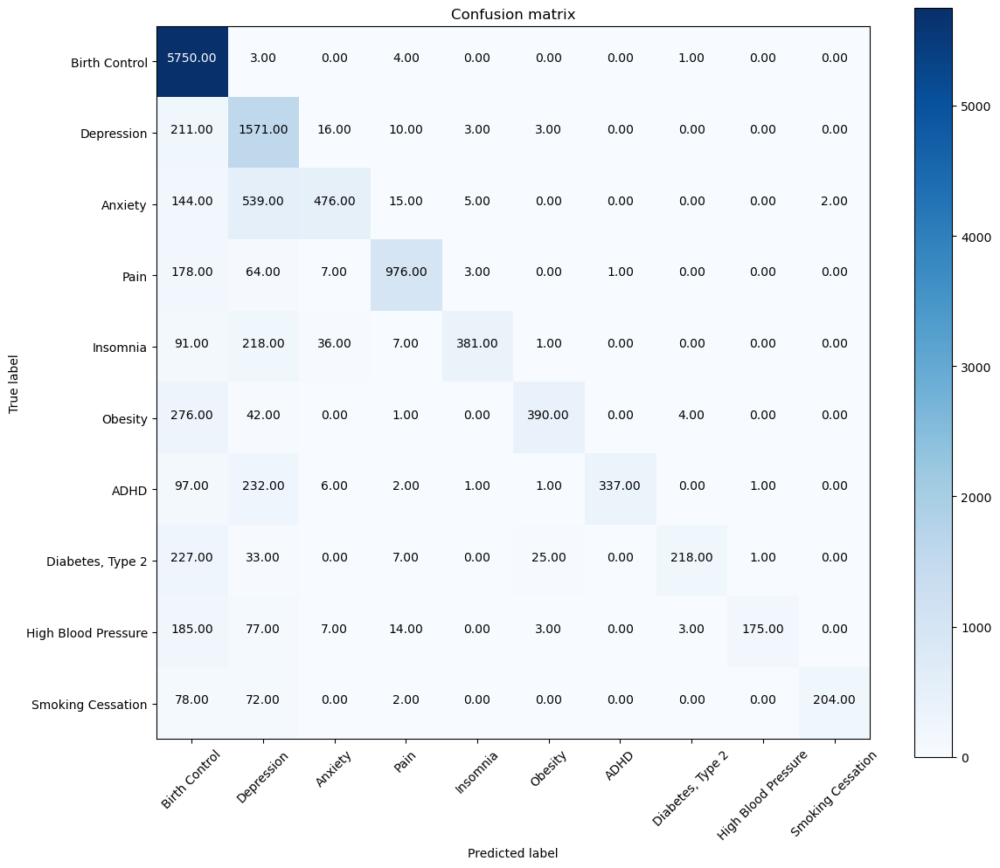

In [40]:
mnb_tf = MultinomialNB()
mnb_tf.fit(tfidf_train_2, y_train)
pred = mnb_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy: %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=['Birth Control', 'Depression', 'Anxiety', 'Pain', 'Insomnia', 'Obesity', 'ADHD', 'Diabetes, Type 2', 'High Blood Pressure', 'Smoking Cessation'])
plot_confusion_matrix(cm, classes=['Birth Control', 'Depression', 'Anxiety', 'Pain', 'Insomnia', 'Obesity', 'ADHD', 'Diabetes, Type 2', 'High Blood Pressure', 'Smoking Cessation'])

## Machine Learning TF-IDF

accuracy: 0.927
Confusion matrix, without normalization


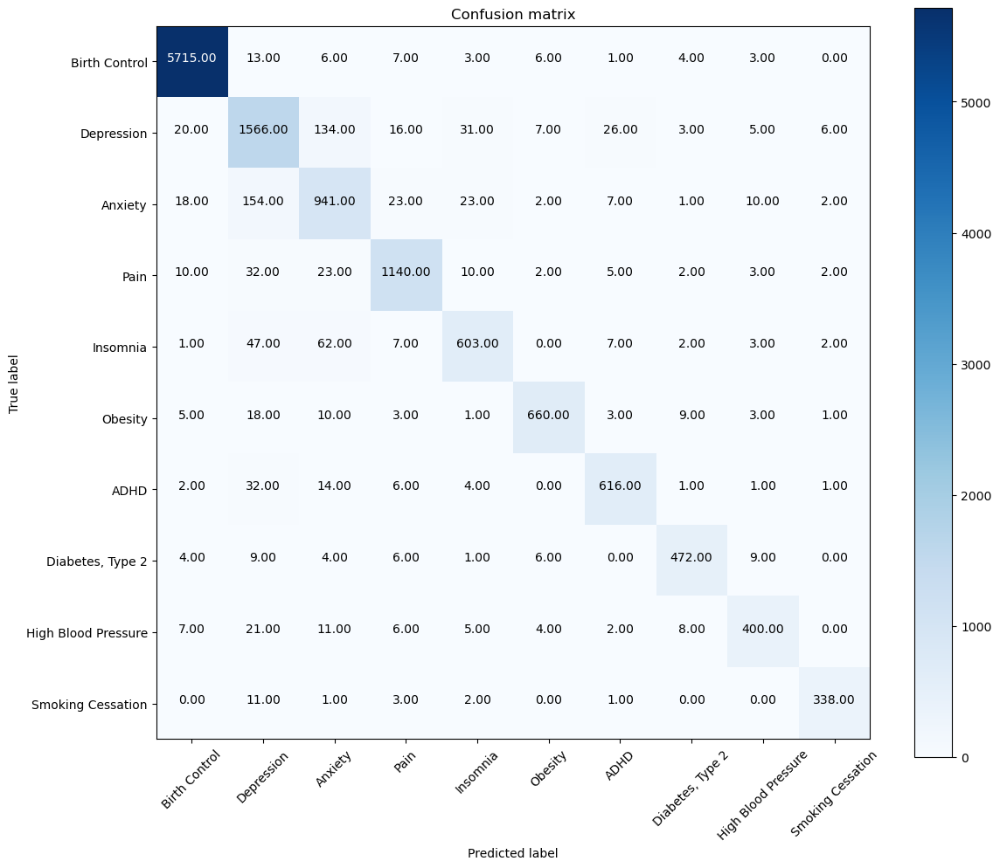

In [55]:
tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train = tfidf_vectorizer.fit_transform(X_train)
tfidf_test = tfidf_vectorizer.transform(X_test)

pass_tf = PassiveAggressiveClassifier()
pass_tf.fit(tfidf_train, y_train)
pred = pass_tf.predict(tfidf_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy: %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=['Birth Control', 'Depression', 'Anxiety', 'Pain', 'Insomnia', 'Obesity', 'ADHD', 'Diabetes, Type 2', 'High Blood Pressure', 'Smoking Cessation'])
plot_confusion_matrix(cm, classes=['Birth Control', 'Depression', 'Anxiety', 'Pain', 'Insomnia', 'Obesity', 'ADHD', 'Diabetes, Type 2', 'High Blood Pressure', 'Smoking Cessation'])

## Fitur-Fitur untuk Prediksi

In [43]:
def most_informative_feature_for_class(vectorizer, classifier, classlabel, n=10):
    labelid = list(classifier.classes_).index(classlabel)
    feature_names = vectorizer.get_feature_names_out()
    topn = sorted(zip(classifier.coef_[labelid], feature_names))[-n:]

    for coef, feat in topn:
        print(classlabel, feat, coef)

In [44]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Birth Control')

Birth Control delayed 0.5648354212455834
Birth Control cheaper 0.5974319876962112
Birth Control crippling 0.6372155391817964
Birth Control advisor 0.7508716740250072
Birth Control securing 0.9160420551811347
Birth Control detector 0.9186056197789223
Birth Control pertained 0.9378784790912964
Birth Control academy 1.0031194876417546
Birth Control addressed 1.081510352994575
Birth Control iin 9.32081524437868


In [45]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Depression')

Depression deadened 0.7323660904996753
Depression scared 0.7470072765634889
Depression personailty 0.9018167952352294
Depression erupt 0.9647707922642581
Depression erupted 0.9647707922642581
Depression stature 0.9692988945882421
Depression thaght 0.9857393759426711
Depression staved 1.1141988213441358
Depression stake 1.3965559259950413
Depression alesyna 5.837465668046975


In [46]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Pain')

Pain weekend 0.8052877077786169
Pain perpetrator 0.8497253740868359
Pain weepy 0.8517898544408221
Pain asset 0.8676168781399355
Pain gangster 0.9190383166110861
Pain copays 0.952214716689219
Pain colorfully 1.2003977032019886
Pain wha 1.2521472034035852
Pain specifically 1.772216260186553
Pain exaggerates 1.9788580509380669


In [47]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Obesity')

Obesity sumatriptan 0.3674526029944804
Obesity quicken 0.3717626034311301
Obesity reflect 0.3824016761681365
Obesity tenseness 0.3824016761681365
Obesity tensing 0.3824016761681365
Obesity quicker 0.38572815773282604
Obesity balanced 0.4369657744599231
Obesity foul 0.46864030358263425
Obesity baked 0.5818098861896424
Obesity exaggerates 0.9246645843602592


In [48]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'ADHD')

ADHD clearish 0.82577210903251
ADHD switchover 0.8806617178752167
ADHD asset 0.9650583022194537
ADHD flack 0.9733247865869872
ADHD anixiety 1.1099687945645433
ADHD trapezium 1.3442630192688911
ADHD vagina 1.9048076951452262
ADHD crumbled 1.9161124626522916
ADHD stove 5.614882495021454
ADHD tremor 8.584612271521943


In [49]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Diabetes, Type 2')

Diabetes, Type 2 hyperness 0.4177701272240359
Diabetes, Type 2 persevere 0.42911249985769173
Diabetes, Type 2 oyxcodone 0.44025993365827526
Diabetes, Type 2 ranging 0.5083316984217371
Diabetes, Type 2 addressed 0.5181490938708678
Diabetes, Type 2 advisor 0.5698809981408233
Diabetes, Type 2 ibufrofen 0.7370360451101547
Diabetes, Type 2 rang 0.7668233767187158
Diabetes, Type 2 belt 0.8136831241586222
Diabetes, Type 2 racket 3.3054605269868693


In [50]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'High Blood Pressure')

High Blood Pressure heyy 0.47361211903485373
High Blood Pressure hadabsolutely 0.47721866409805985
High Blood Pressure hosptilized 0.47860799879186966
High Blood Pressure snow 0.4960228664656799
High Blood Pressure hospitali 0.551612377037456
High Blood Pressure beleived 0.6794258706675012
High Blood Pressure believe 0.7435644546969636
High Blood Pressure sparing 0.8027990127236445
High Blood Pressure gagged 0.8263419054678068
High Blood Pressure gabepen 0.8738963960454487


In [51]:
most_informative_feature_for_class(tfidf_vectorizer, pass_tf, 'Smoking Cessation')

Smoking Cessation vivanse 0.3179565762807396
Smoking Cessation asks 0.31972599651214534
Smoking Cessation spite 0.3395743581946543
Smoking Cessation spoken 0.36973686313819115
Smoking Cessation spokesperson 0.36973686313819115
Smoking Cessation waight 0.37164573635746456
Smoking Cessation temporomandibular 0.38493481229118937
Smoking Cessation asleeep 0.4104661971196137
Smoking Cessation asleep 0.4104661971196137
Smoking Cessation wha 0.740149260789013


## Sample Prediction

In [52]:
X.tail()

,condition,review,review_clean
161278,"Diabetes, Type 2",I just got diagnosed with type 2. My doctor prescribed Invokana and metformin from the beginning. My sugars went down to normal by the second week. I am losing so much weight. No side effects yet. Miracle medicine for me,got diagnosed type doctor prescribed invokana metformin beginning sugar went normal second week losing much weight side effect yet miracle medicine
161286,Depression,"This is the third med I&#039;ve tried for anxiety and mild depression. Been on it for a week and I hate it so much. I am so dizzy, I have major diarrhea and feel worse than I started. Contacting my doc in the am and changing asap.",third med tried anxiety mild depression week hate much dizzy major diarrhea feel worse started contacting doc changing asap
161287,Anxiety,"I was super against taking medication. I&#039;ve started dealing with anxiety (some depression) for awhile now. I got prescribed Ativan months ago, and never took it. I thought I could handle myself again but then my relationship started to fail because of my over thinking. I went back to the doctor, and decided to try it. She prescribed me .50 3 times a day. I took a full one at night after a bad panic attack, and within 30 minutes I was calm and slept through the entire night. I have only been taking a half morning and mid afternoon and full at night because it does make you feel tired. My brain is in a slight fog, but nothing crazy, I still know whats going on though :) Give it a try if you are suffering. You will know after 1.",super taking medication started dealing anxiety depression awhile got prescribed ativan month ago never took thought could handle relationship started fail thinking went back doctor decided try prescribed time day took full one night bad panic attack within minute calm slept entire night taking half morning mid afternoon full night make feel tired brain slight fog nothing crazy still know whats going though give try suffering know
161290,High Blood Pressure,"I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations.",tekturna day effect immediate also calcium channel blocker tiazac hydrochlorothiazide put tekturna palpitation experienced diovan ugly drug opinion company produce however palpitation pretty bad diovan hour monitor ekg etc day substituting tekturna diovan palpitation
161291,Birth Control,"This would be my second month on Junel. I&#039;ve been on Birth Control for about 10 years now. I changed due to spotting and increased mood swings with my previous birth control. Since the switch I have had shorter periods about 2-3 days, but I have gained major weight and increased appetite. I switched up my regular exercise routine and still have not managed to drop the extra 7 lbs ;(",would second month junel birth control year changed due spotting increased mood swing previous birth control since switch shorter period day gained major weight increased appetite switched regular exercise routine still managed drop extra lb


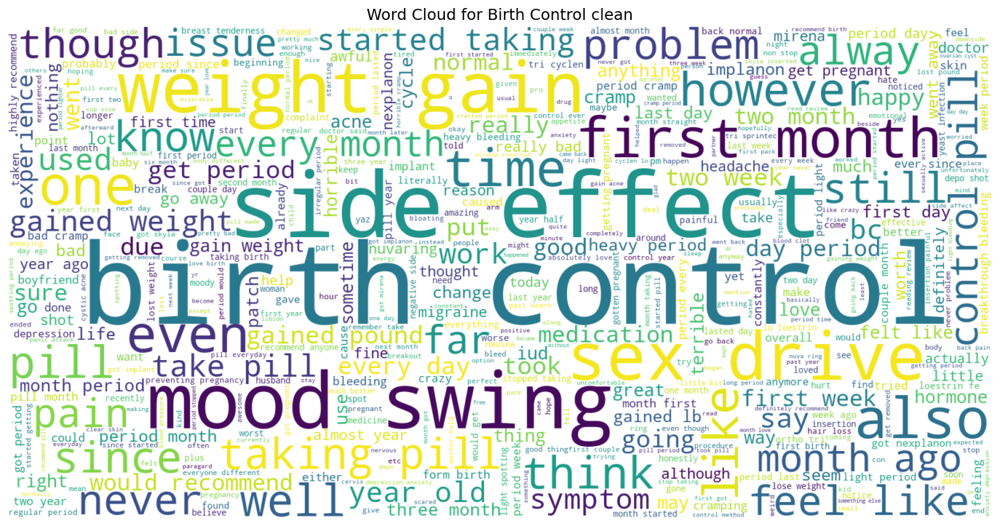

In [70]:
# Word Cloud Birth Control untuk review_clean
from wordcloud import WordCloud

# Filter data untuk kondisi 'Birth Control'
text_birth_control = " ".join(review for review in X[X['condition'] == 'Birth Control']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_birth_control)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Birth Control clean', fontsize=14)
plt.show()

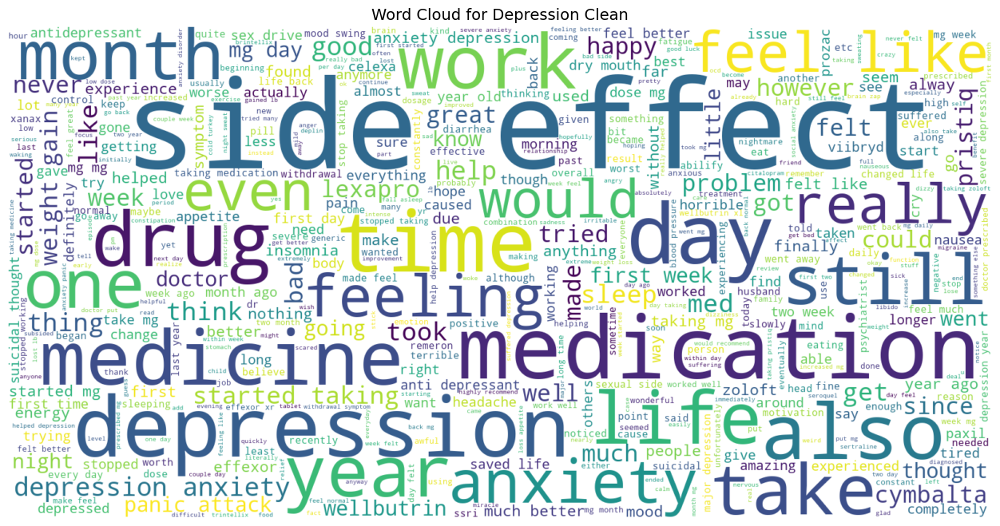

In [71]:
# Word Cloud Depression untuk review_clean
text_depression = " ".join(review for review in X[X['condition'] == 'Depression']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_depression)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Depression Clean', fontsize=14)
plt.show()

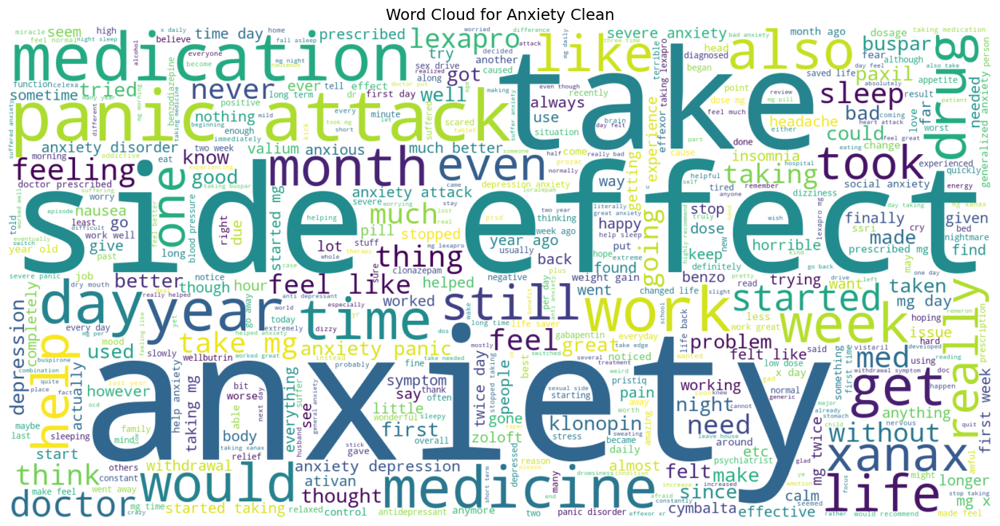

In [76]:
# Word Cloud Anxiety untuk review_clean
text_anxiety = " ".join(review for review in X[X['condition'] == 'Anxiety']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_anxiety)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Anxiety Clean', fontsize=14)
plt.show()

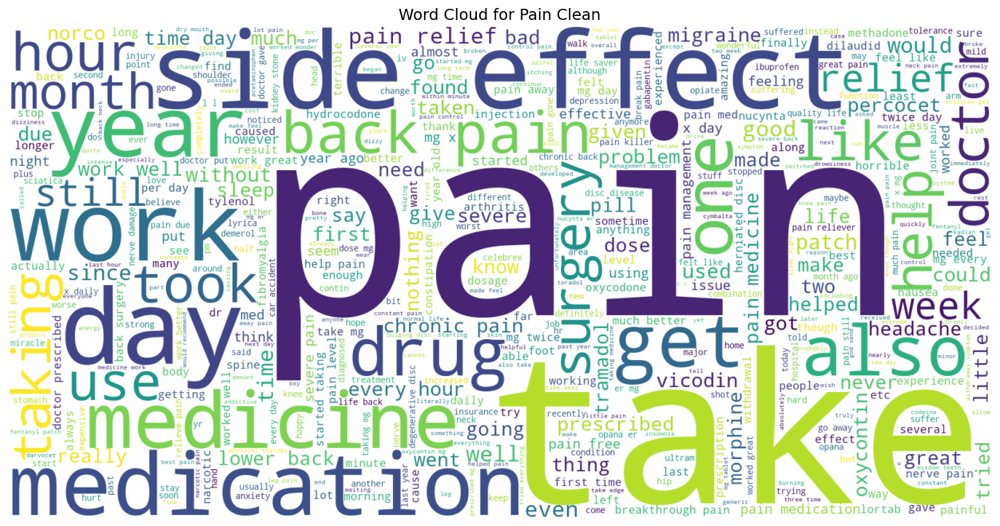

In [72]:
# Word Cloud Pain untuk review_clean
text_pain = " ".join(review for review in X[X['condition'] == 'Pain']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_pain)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Pain Clean', fontsize=14)
plt.show()

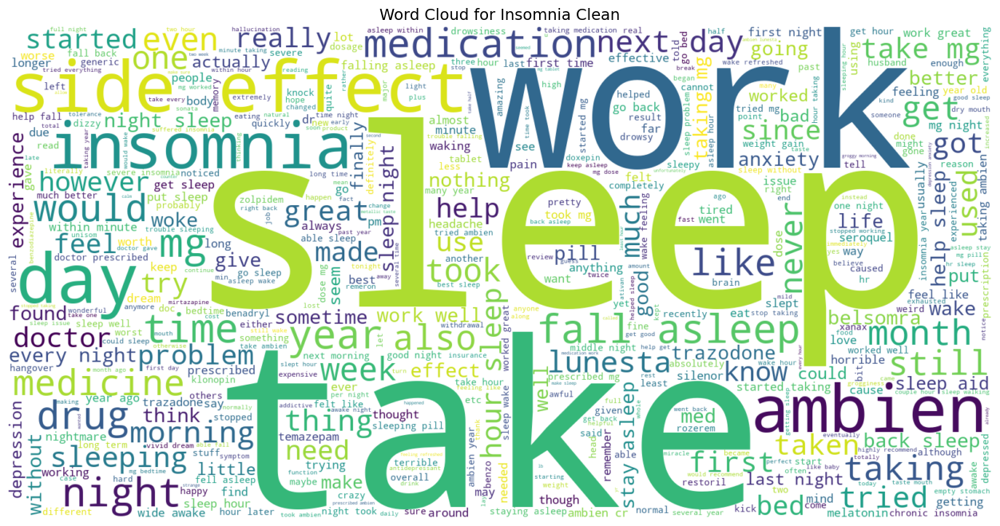

In [73]:
# Word Cloud Insomnia untuk review_clean
text_insomnia = " ".join(review for review in X[X['condition'] == 'Insomnia']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_insomnia)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Insomnia Clean', fontsize=14)
plt.show()

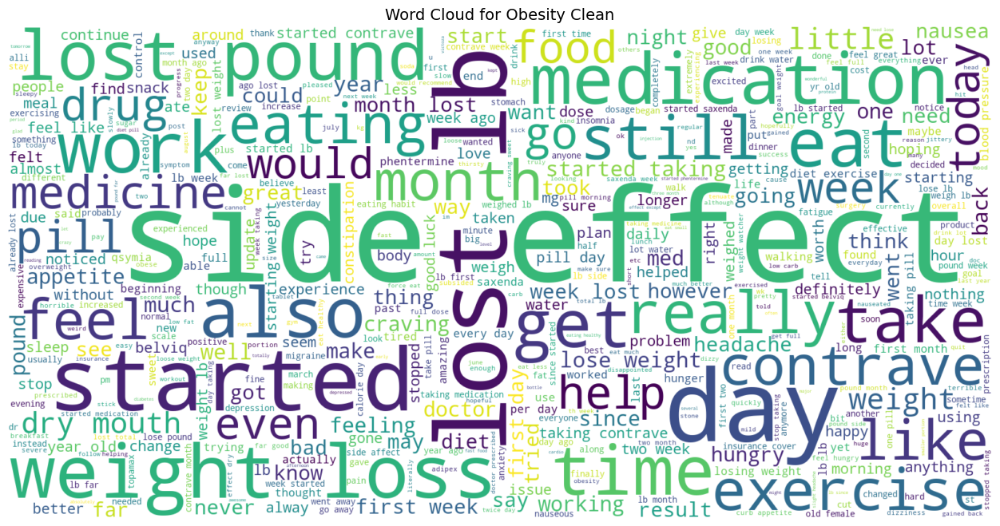

In [74]:
# Word Cloud Obesity untuk review_clean
text_obesity = " ".join(review for review in X[X['condition'] == 'Obesity']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_obesity)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Obesity Clean', fontsize=14)
plt.show()

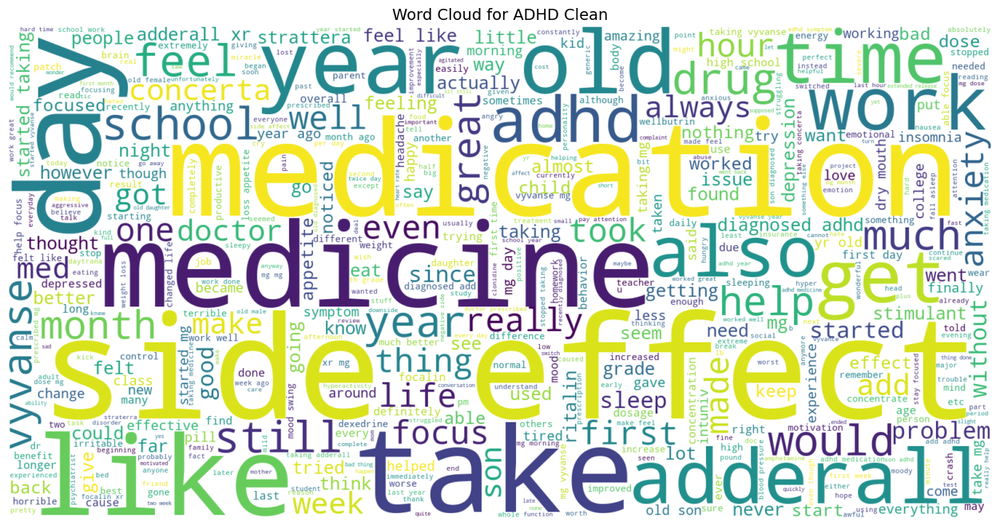

In [75]:
# Word Cloud ADHD untuk review_clean
text_adhd = " ".join(review for review in X[X['condition'] == 'ADHD']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_adhd)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for ADHD Clean', fontsize=14)
plt.show()

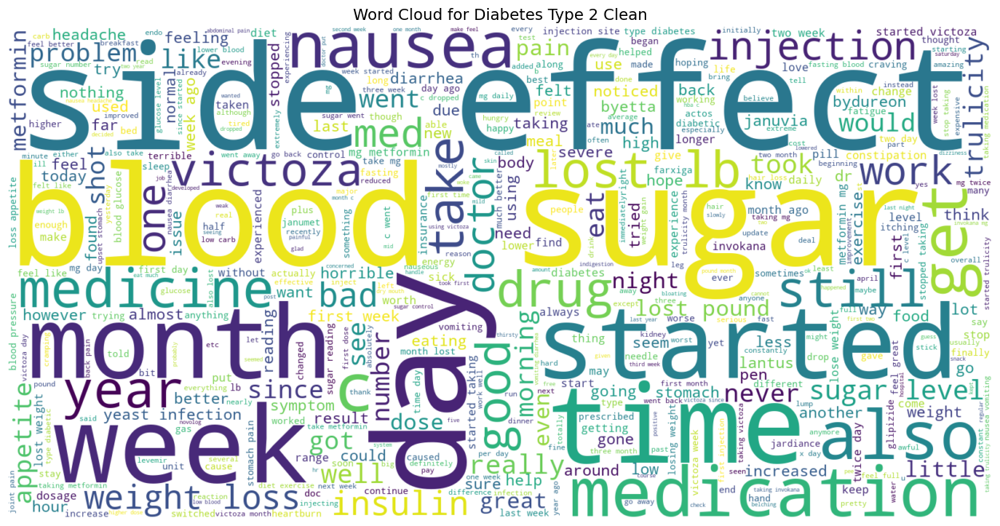

In [77]:
# Word Cloud Diabetes Type 2 untuk review_clean
text_diabetesType2 = " ".join(review for review in X[X['condition'] == 'Diabetes, Type 2']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_diabetesType2)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Diabetes Type 2 Clean', fontsize=14)
plt.show()

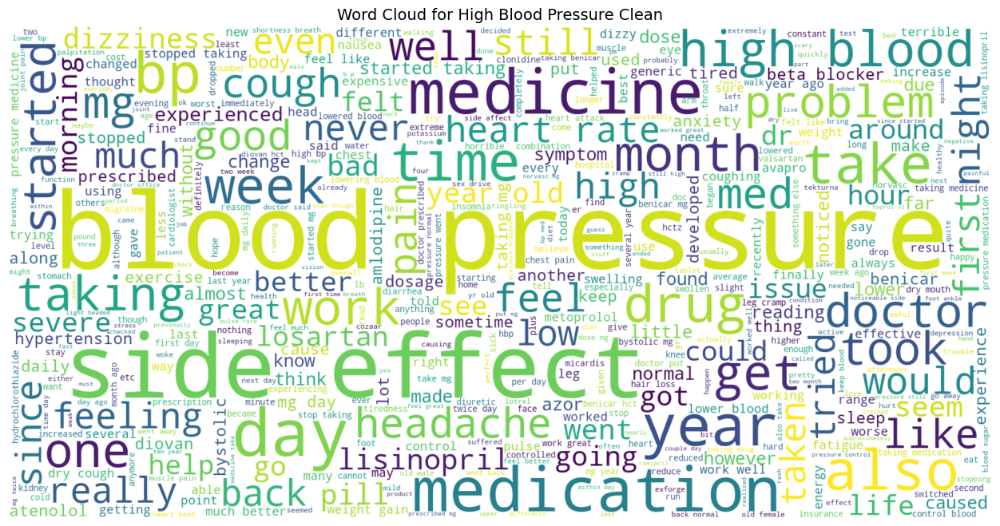

In [78]:
# Word Cloud High Blood Pressure untuk review_clean
text_highBlood = " ".join(review for review in X[X['condition'] == 'High Blood Pressure']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_highBlood)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for High Blood Pressure Clean', fontsize=14)
plt.show()

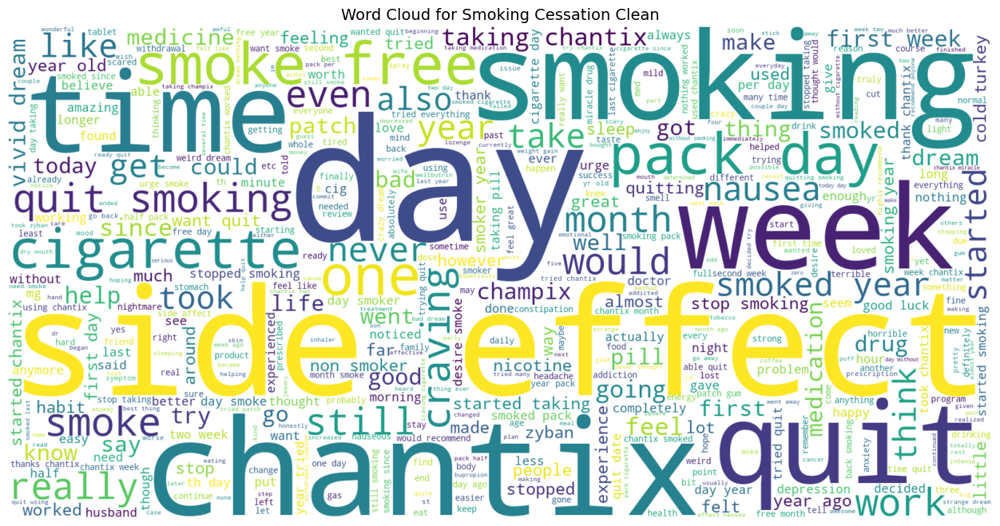

In [79]:
# Word Cloud Smoking Cessation untuk review_clean
text_smoking = " ".join(review for review in X[X['condition'] == 'Smoking Cessation']['review_clean'])

# Buat WordCloud
plt.figure(figsize=(16, 8))
wc = WordCloud(stopwords=stop, max_words=500, background_color="white", width=1600, height=800).generate(text_smoking)

# Tampilkan WordCloud
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Smoking Cessation Clean', fontsize=14)
plt.show()

## Perbandingan Panjang Teks Review dan Review_Clean

In [80]:
# Hitung panjang teks di kolom 'review' dan 'review_clean'
X['review_length'] = X['review'].apply(lambda x: len(x.split()))
X['review_clean_length'] = X['review_clean'].apply(lambda x: len(x.split()))

In [81]:
length_comparison = X[['review_length', 'review_clean_length']]

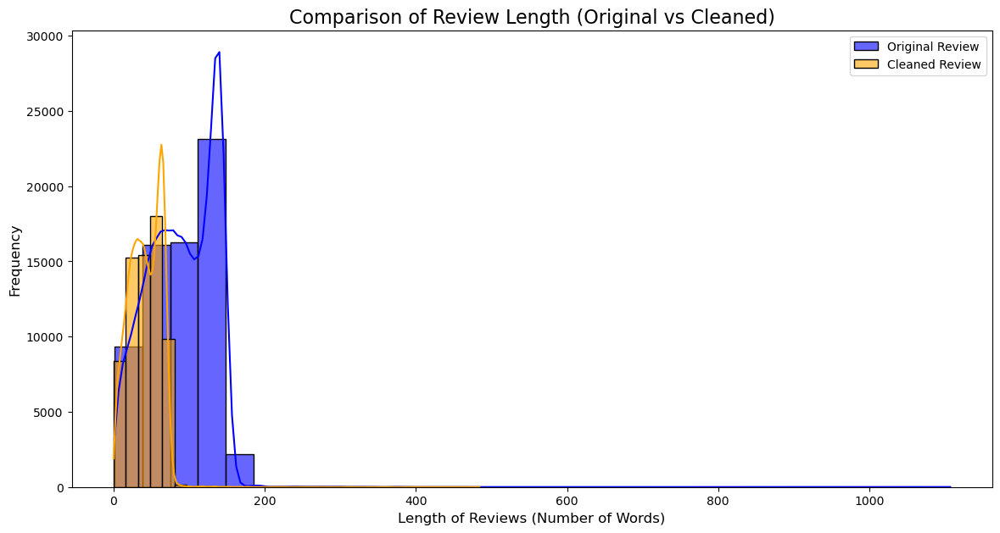

In [82]:
# Membuat histogram untuk perbandingan
plt.figure(figsize=(14, 7))
sns.histplot(length_comparison['review_length'], color='blue', label='Original Review', kde=True, bins=30, alpha=0.6)
sns.histplot(length_comparison['review_clean_length'], color='orange', label='Cleaned Review', kde=True, bins=30, alpha=0.6)
plt.title('Comparison of Review Length (Original vs Cleaned)', fontsize=16)
plt.xlabel('Length of Reviews (Number of Words)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.legend()
plt.show()

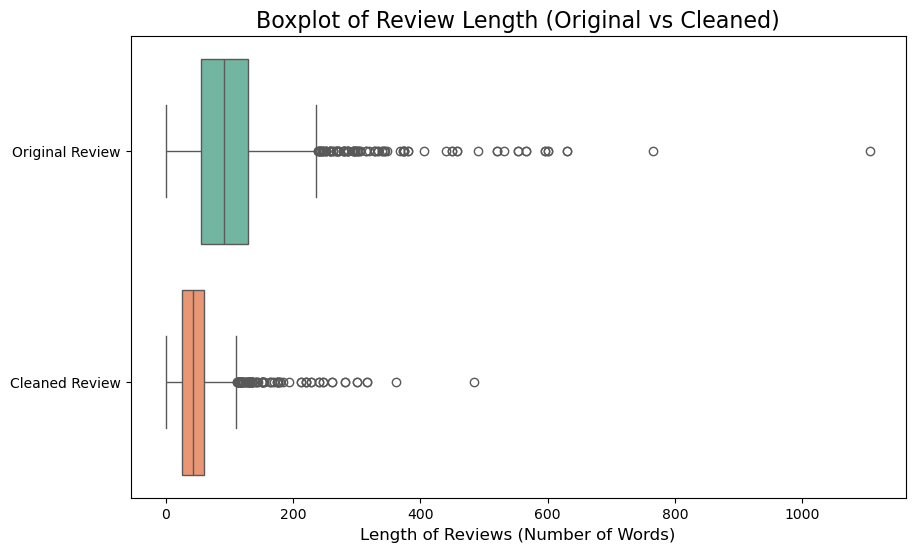

In [84]:
# Membuat boxplot untuk perbandingan
plt.figure(figsize=(10, 6))
sns.boxplot(data=length_comparison, orient='h', palette='Set2')
plt.title('Boxplot of Review Length (Original vs Cleaned)', fontsize=16)
plt.xlabel('Length of Reviews (Number of Words)', fontsize=12)
plt.yticks([0, 1], ['Original Review', 'Cleaned Review'])
plt.show()

## Melakukan Pengujian

In [56]:
text = ["I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'High Blood Pressure'

In [89]:
text = ["This is the third med I&#039;ve tried for anxiety and mild depression. Been on it for a week and I hate it so much. I am so dizzy, I have major diarrhea and feel worse than I started. Contacting my doc in the am and changing asap."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Depression'

In [90]:
text = ["This would be my second month on Junel. I&#039;ve been on Birth Control for about 10 years now. I changed due to spotting and increased mood swings with my previous birth control. Since the switch I have had shorter periods about 2-3 days, but I have gained major weight and increased appetite. I switched up my regular exercise routine and still have not managed to drop the extra 7 lbs ;("]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Birth Control'

In [96]:
text = ["My son is halfway through his fourth week of Intuniv. We became concerned when he began this last week, when he started taking the highest dose he will be on. For two days, he could hardly get out of bed, was very cranky, and slept for nearly 8 hours on a drive home from school vacation (very unusual for him.) I called his doctor on Monday morning and she said to stick it out a few days. See how he did at school, and with getting up in the morning. The last two days have been problem free. He is MUCH more agreeable than ever. He is less emotional (a good thing), less cranky. He is remembering all the things he should. Overall his behavior is better. \r\nWe have tried many different medications and so far this is the most effective."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'ADHD'

In [97]:
text = ["I’ve had anxiety for years and was prescribed Lexapro. The first few days were rough with nausea and dizziness, but after about two weeks, I felt a significant improvement in my anxiety. I’m still a bit more nervous than I’d like to be, but the constant panic attacks have decreased a lot."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Anxiety'

In [100]:
text = ["I started taking Saxenda for weight loss. At first, it suppressed my appetite a lot, and I started shedding some pounds. But I’ve hit a plateau after losing 15 pounds and I’m starting to feel discouraged. The nausea is also starting to get to me."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Obesity'

In [98]:
text = ["I was diagnosed with Type 2 diabetes and started taking Metformin. It’s been working well so far in controlling my blood sugar levels. I haven’t noticed any major side effects, but I’m trying to watch my diet more closely to see better results."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Diabetes, Type 2'

In [99]:
text = ["I’ve been using Tekturna for my high blood pressure. After just a week, my blood pressure has improved, and I no longer feel the palpitations I had with my previous medication, Diovan. It’s working much better for me."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'High Blood Pressure'

In [101]:
text = ["I started using Chantix to quit smoking. The cravings have gone down, and I feel less tempted to smoke. However, I’ve been experiencing some strange dreams and occasional nausea. Still, it’s helping me stick to quitting."]
test = tfidf_vectorizer.transform(text)
pred1 = pass_tf.predict(test)[0]
pred1

'Smoking Cessation'

## Prediksi Menggunakan Bahasa Indonesia

In [89]:
from googletrans import Translator

# Inisialisasi translator
translator = Translator()

# Function Menerjemahkan Bahasa Indonesia Otomatis ke Bahasa Ingrris
def predict_condition(input_text_id):
    # Terjemahkan teks input ke bahasa Inggris
    translated_text = translator.translate(input_text_id, src='id', dest='en').text
    
    # Lakukan prediksi dengan model yang dilatih
    test = tfidf_vectorizer.transform([translated_text])
    prediction = pass_tf.predict(test)[0]
    return prediction

In [92]:
test = "Saya telah mengalami kecemasan selama bertahun-tahun dan diberi resep Lexapro. Beberapa hari pertama cukup sulit dengan mual dan pusing, tetapi setelah sekitar dua minggu, saya merasakan peningkatan yang signifikan dalam kecemasan saya. Saya masih sedikit lebih gugup daripada yang saya inginkan, tetapi serangan panik yang terus-menerus telah banyak berkurang."
predicted_condition = predict_condition(test)
print("Predicted Condition:", predicted_condition)

Predicted Condition: Anxiety


In [93]:
test2 = "Tekanan darah saya tinggi"
predicted_condition = predict_condition(test2)
print("Predicted Condition:", predicted_condition)

Predicted Condition: High Blood Pressure
